<a href="https://colab.research.google.com/github/naydennenkov/ML_examples/blob/master/Copy_of_fashion_mnist_prevent_overfitting_bg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Анализ качеството на работа на невронна мрежа за разпознаване модели на дрехи в Keras

За да пуснете и редактирате кода, запишете копие на този ноутбук за себе си (File->Save a copy in Drive...). Своето копие вие ще можете да изменяте и пускате.

In [ ]:
from tensorflow.keras.datasets import fashion_mnist
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras import utils
from tensorflow.keras.preprocessing import image
from google.colab import files
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
%matplotlib inline 

## Подготовка на данните за обучение на мрежата

**Зареждане множеството с данни**

In [ ]:
# В Keras са вложени средства за работа с популярни множества от данни
# (x_train, y_train) - множество с данных за обучение
# (x_test, y_test) - # (x_train, y_train) - множество с данных за тестване
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

4423680/4422102 [==============================] - 0s 0us/step


Списък с имена на класовете

In [ ]:
classes = ['футболка', 'брюки', 'свитер', 'платье', 'пальто', 'туфли', 'рубашка', 'кроссовки', 'сумка', 'ботинки']

Преглед на примери с изображения

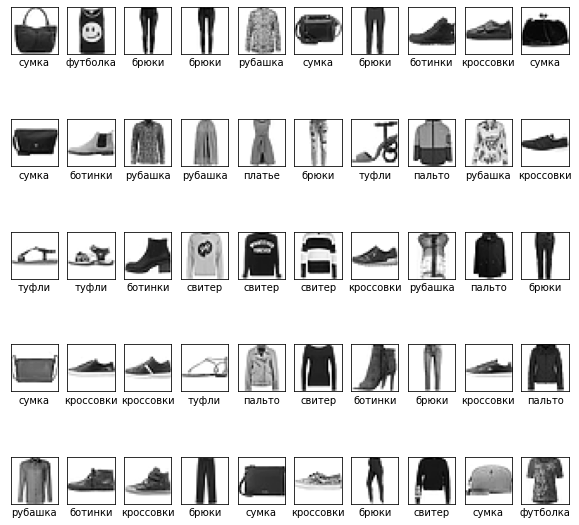

In [ ]:
plt.figure(figsize=(10,10))
for i in range(100,150):
    plt.subplot(5,10,i-100+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_train[i], cmap=plt.cm.binary)
    plt.xlabel(classes[y_train[i]])

**Преобразуване на размерността на данните в множеството**

In [ ]:
x_train = x_train.reshape(60000, 784)
x_test = x_test.reshape(10000, 784)

**Нормализация на данните**

In [ ]:
# Векторни операции
# Прилагата се за всеки елемент от масива по отделно
x_train = x_train / 255 
x_test = x_test / 255 

**Работа с правилни отговори**

In [ ]:
n = 0

In [ ]:
print(y_train[n])

9


**Преобруване на таговете във формат one hot encoding**

In [ ]:
y_train = utils.to_categorical(y_train, 10)

In [ ]:
y_test = utils.to_categorical(y_test, 10)

**Правилния отговор във формат one hot encoding**

In [ ]:
print(y_train[n])

[0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]


## Създаване на невронна мрежа

**Создаем последовательную модель**

In [ ]:
# Создаем последовательную модель
model = Sequential()
# Входной полносвязный слой, 800 нейронов, 784 входа в каждый нейрон
model.add(Dense(800, input_dim=784, activation="relu"))
# Выходной полносвязный слой, 10 нейронов (по количеству рукописных цифр)
model.add(Dense(10, activation="softmax"))

**Компилируем сеть**

In [ ]:
model.compile(loss="categorical_crossentropy", optimizer="SGD", metrics=["accuracy"])

print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 800)               628000    
_________________________________________________________________
dense_1 (Dense)              (None, 10)                8010      
Total params: 636,010
Trainable params: 636,010
Non-trainable params: 0
_________________________________________________________________
None


## Обучаване на невронна мрежа

In [ ]:
history = model.fit(x_train, y_train, 
                    batch_size=200, 
                    epochs=100,
                    validation_split=0.2,
                    verbose=1)

Epoch 1/100
240/240 [==============================] - 1s 4ms/step - loss: 1.2067 - accuracy: 0.6484 - val_loss: 0.8355 - val_accuracy: 0.7430
Epoch 2/100
240/240 [==============================] - 1s 3ms/step - loss: 0.7603 - accuracy: 0.7639 - val_loss: 0.6917 - val_accuracy: 0.7863
Epoch 3/100
240/240 [==============================] - 1s 3ms/step - loss: 0.6618 - accuracy: 0.7947 - val_loss: 0.6268 - val_accuracy: 0.8011
Epoch 4/100
240/240 [==============================] - 1s 3ms/step - loss: 0.6092 - accuracy: 0.8070 - val_loss: 0.5866 - val_accuracy: 0.8121
Epoch 5/100
240/240 [==============================] - 1s 3ms/step - loss: 0.5753 - accuracy: 0.8164 - val_loss: 0.5599 - val_accuracy: 0.8187
Epoch 6/100
240/240 [==============================] - 1s 3ms/step - loss: 0.5507 - accuracy: 0.8221 - val_loss: 0.5394 - val_accuracy: 0.8225
Epoch 7/100
240/240 [==============================] - 1s 3ms/step - loss: 0.5320 - accuracy: 0.8261 - val_loss: 0.5290 - val_accuracy: 0.8229

## Съхраняване на невронната мрежа за последващо използване

In [ ]:
model.save('fashion_mnist_dense.h5')

## Оценка качестото на обучение

Проверка качества работы на наборе данных для тестирования

In [ ]:
scores = model.evaluate(x_test, y_test, verbose=1)

313/313 [==============================] - 1s 2ms/step - loss: 0.3778 - accuracy: 0.8657


In [ ]:
print("Доля верных ответов на тестовых данных, в процентах:", round(scores[1] * 100, 4))

Доля верных ответов на тестовых данных, в процентах: 86.57


## Използваме мрежата за разпознаване на предмета върху дрехите

In [ ]:
n_rec = 496

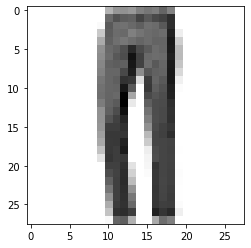

In [ ]:
plt.imshow(x_test[n_rec].reshape(28, 28), cmap=plt.cm.binary)
plt.show()

**Меняем размерность изображения и нормализуем его**

In [ ]:
x = x_test[n_rec]
x = np.expand_dims(x, axis=0)

**Запускаем распознавание**

In [ ]:
prediction = model.predict(x)

**Печатаем результаты распознавания**

In [ ]:
prediction

array([[3.6366502e-05, 9.9983239e-01, 1.0221023e-05, 1.1193043e-04,
        6.9068010e-06, 1.1729020e-08, 4.9611396e-07, 1.2376888e-07,
        1.5446633e-06, 1.1610872e-08]], dtype=float32)

**Преобразуем результаты из формата one hot encoding**

In [ ]:
prediction = np.argmax(prediction[0])
print("Номер класса:", prediction)
print("Название класса:", classes[prediction])


Номер класса: 1
Название класса: брюки


**Печатаем правильный ответ**

In [ ]:
label = np.argmax(y_test[0])
print("Номер класса:", label)
print("Название класса:", classes[label])

Номер класса: 9
Название класса: ботинки


## Зареждане на своята картинка

In [ ]:
files.upload()

Saving fashion_mnist_dense (1).h5 to fashion_mnist_dense (1).h5


{'fashion_mnist_dense (1).h5': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x08\xdat\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x08\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00\x18\x01\x00\x00\x00\x00\x00\x00TREE\x00\x00\x01\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

Проверка на заредената картинка

In [ ]:
!ls

'fashion_mnist_dense (1).h5'   sample_data


Зареждане на картинката от файла

In [ ]:
img_path = 'tshirt.jpg'
img = image.load_img(img_path, target_size=(28, 28), color_mode = "grayscale")

Показване на картинката

In [ ]:
plt.imshow(img.convert('RGBA'))
plt.show()

Преобразуване на накартинката за обработка от невронната мрежа

In [ ]:
# Преобразуваме картинката в масив
x = image.img_to_array(img)
# Промяняме формата на масива в плосък вектор
x = x.reshape(1, 784)
# Инвертираме изображението
x = 255 - x
# Нормализираме изображението
x /= 255

Пускаме за разпознаване

In [ ]:
prediction = model.predict(x)

Резултат от разпознаването

In [ ]:
prediction

In [ ]:
prediction = np.argmax(prediction)
print("Номер на класа:", prediction)
print("Име на класа:", classes[prediction])

## Идеи за изменение на архитектурата на невронната мрежа

1. Изпробвайте да използвате различно количество неврони във входния слой: 400, 600, 800, 1200.
2. Добавете в невронната мрежа скрит слой с различни количества неврони: 200, 300, 400, 600, 800.
3. Добавете нясколко скрити слоя в мрежата с различни количества неврони във всеки слой.
3. Използвайте различен брой епохи: 10, 15, 20, 25, 30.
4. Изплзвайте различни размери на мини-подпобра (batch_size): 10, 50, 100, 200, 500.
 

Подберете различни комбинации от хиперпараметри, така че да се получи по-добър  резултат от тестовото множество с данни.

Убедете се, че вашия модел не се преобучава.